In [1]:
from PIL import Image
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter
%matplotlib inline
from mpl_toolkits import mplot3d

import plotly.express as px

## Method to normalise pixel values of the picture.

In [2]:
def norm_pix(data):
    for i in range(data.shape[2]):
        mi = float(data[..., i].min())
        ma = float(data[..., i].max())
        for j in range(data.shape[0]):
            for k in range(data.shape[1]):
                data[j][k][i]=(data[j][k][i]-mi)/(ma-mi)
    return data

## Method to convert data to list format

In [3]:
def create_data(data):
    shape = data.shape
    final = []
    for i in range(shape[0]):
        t1 = []
        for j in range(shape[1]):
            t2=[i/(shape[0]-1),j/(shape[1]-1)]
            t2.append(data[i][j][0])
            t2.append(data[i][j][1])
            t2.append(data[i][j][2])
            t1.append(t2)
        final.append(t1)
    return final

## Method to Preprocess an image and give normalised dataframe with x, y, r, g, b values.

In [4]:
def preprocess(path):
    img = Image.open(path)
    img = np.array(img)
    img = img.astype('float32')
    
    norm_img = norm_pix(img)
    norm_img = create_data(norm_img)
    final = []
    for i in range(len(norm_img)):
        for j in range(len(norm_img[0])):
            final.append(norm_img[i][j])
            
    return(pd.DataFrame(final, columns =['x', 'y', 'r', 'g', 'b'], dtype = float))

# Principal Component Analysis
## Method to get the principal components of a dataframe.

In [5]:
def get_pca(path):
    data = preprocess(path)
    pca = PCA()
    principalComponents = pca.fit_transform(data)
    principalComponents = pd.DataFrame(data = principalComponents,
                                       columns = ['PC1','PC2','PC3','PC4','PC5'])
    return(pca,principalComponents)

## Method to draw a Pareto plot for the PCA

In [7]:
def plot_pareto(pca):
    
    plt.bar(['PC1','PC2','PC3','PC4','PC5'],pca.explained_variance_ratio_)
    df = pd.DataFrame({'var':pca.explained_variance_ratio_,
                       'PC':['PC1','PC2','PC3','PC4','PC5']})
    df["cummulative"] = df["var"].cumsum()/df["var"].sum()*100
    
    
    fig, ax = plt.subplots()
    ax.bar(df['PC'], df["var"])
    ax2 = ax.twinx()
    ax2.plot(df['PC'], df["cummulative"], color="C1", marker="D")
    ax2.yaxis.set_major_formatter(PercentFormatter())

    ax.tick_params(axis="y", colors="C0")
    ax2.tick_params(axis="y", colors="C1")
    plt.show()

## Method to plot the Principal components in 3D

In [8]:
def plot_PCA(principalComponents):
    fig = px.scatter_3d(principalComponents, x='PC1', y='PC2', z='PC3')
    fig.update_traces(marker=dict(size=1, line=dict(width=2)),
                      selector=dict(mode='markers'))
    fig.show()

## Method to plot the Principal components in 2D

In [9]:
def plot_PCA_2D(principalComponents):
    plt.scatter(principalComponents['PC1'], principalComponents['PC2'],s=1)
    plt.gca().invert_yaxis()
    plt.show()

### Now we import an image and preprocess it to convert it into a dataframe with x, y, r, g, b. Where x and y are the position of the pixel in the image and r, g, b values are the pixel values.
### We then find the principal components of this data. and plot the pareto to check how many principal components are important.

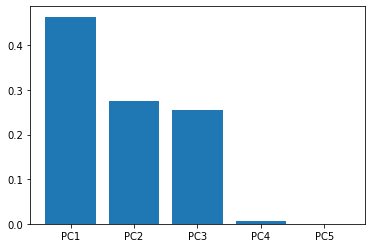

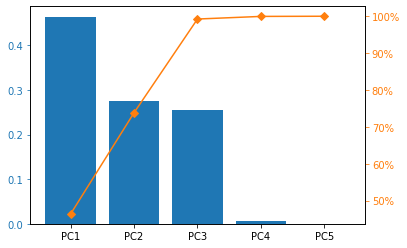

In [15]:
pca , principalComponents = get_pca('42049_colorBird.jpg')
plot_pareto(pca)

### As we can see the smallest, reasonable value of D to present a good representation of this data is 3.
### As almost 99% of the data is represented with the first three components. The varies with data.
### Always choose the first N components that represent more than 70+ percent of the data.

### We can now plot the top 2 principal components which contain more than 70 percent of the data.

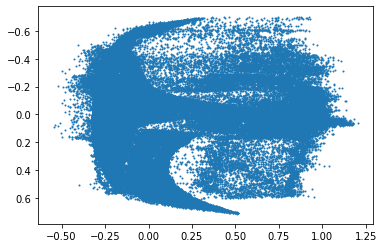

In [16]:
plot_PCA_2D(principalComponents)

### We can now plot the top 3 principal components which contain more than 99 percent of the data.

In [17]:
plot_PCA(principalComponents)

# t-Distributed Stochastic Neighbor Embedding

## Method to Apply t-SNE and get the dimensionally reduced data.

In [18]:
def get_tsne(data, n_components, perplexity):
    
    tsne = TSNE(n_components=n_components, perplexity=perplexity)
    Entities = tsne.fit_transform(data)
    Entities = pd.DataFrame(data = Entities,columns = ['E1','E2'])
    return(tsne,Entities)


## Method to plot the dimensionally reduced data.

In [20]:
def plot_tsne(Entities):
    plt.scatter(Entities['E1'], Entities['E2'],s=1)
    plt.gca().invert_yaxis()
    plt.show()

### Now we import an image and preprocess it to convert it into a dataframe with x, y, r, g, b. Where x and y are the position of the pixel in the image and r, g, b values are the pixel values.
### We then apply t-SNE on this data to reduce the data from 5 dimensions to 2 dimensions. 
### We will try different perplexities and choose the best. The perplexities can be changed depending on the results. Different perplexities work well with different data.

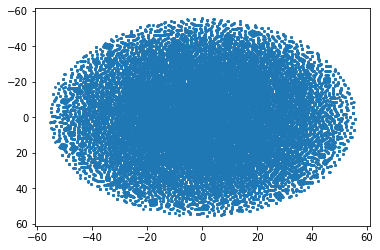

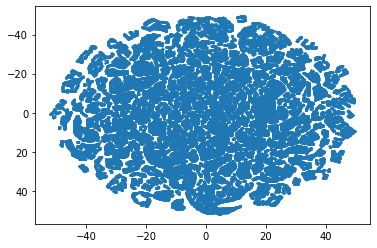

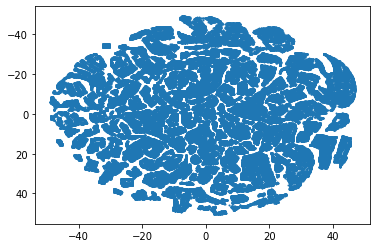

In [21]:
bird = np.array(preprocess('42049_colorBird.jpg'))

for perp in [5,30,50]:
    tsne_bird , Entities_bird = get_tsne(bird,2, perp)
    plot_tsne(Entities_bird)

#### As we can see with perplexity our clusters come closer.

### If the whole image data takes too long to process we can take 10,000 random pixels from the image to find the t-SNE this also gives relatively good results in faster time.

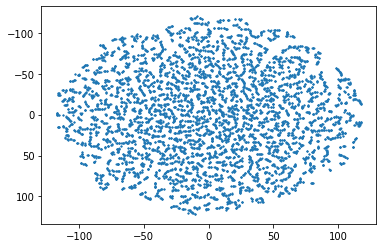

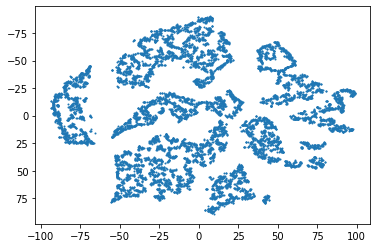

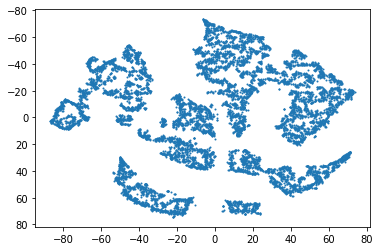

In [22]:
bird = np.array(preprocess('42049_colorBird.jpg'))

# creating random 10,000 indexes.
idx = np.random.randint(len(bird), size=10000)
bird = bird[idx,:]

for perp in [5,30,50]:
    tsne_bird , Entities_bird = get_tsne(bird,2, perp)
    plot_tsne(Entities_bird)

#### If observed, the same perplexities in different sized datasets are giving different types of plots. We can see that higher the data points higher the perplexity required. Now for the whole image we can try perplexity of 200.

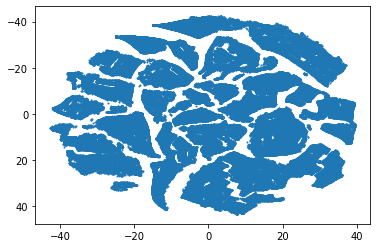

In [23]:
bird = np.array(preprocess('42049_colorBird.jpg'))

tsne_bird , Entities_bird = get_tsne(bird,2, 200)
plot_tsne(Entities_bird)

#### This shows that the perplexity should increase as the number of data points increase. 